# PDF Parsing and Topic Extraction - Experiment 1
* Notebook by Adam Lang
* Date: 1/29/2025

# Overview and Process
* In this notebook experiment we will upload a publicly available corporate strategy document from Moderna as a PDF and then extract the information using a PDF parser library such as llamaparse or pymupdf4llm.
* Then we will perform topic modeling using BERTopic with Llama-3.1-8B-instruct open source LLM to extract meaningful topics from the PDF information.
* Then we will export those topics with keywords to a csv document for later upload to a Graph DB for RAG queries. 

# 1. PDF Upload and Data Extraction
* This will use PyMuPDF4llm. First we need to install it then load it. 

In [4]:
%%capture
!pip install pymupdf4llm

In [5]:
import pymupdf4llm

In [6]:
%%time

## load to pdf variable
fname = 'Moderna-3Q24-Earnings-Presentation-FINAL (1).pdf'
pdf_text = pymupdf4llm.to_markdown(fname)
# save text to disk
with open(fname + ' - pypdf2.md', "w") as f:
    f.write(pdf_text)


Processing Moderna-3Q24-Earnings-Presentation-FINAL (1).pdf...
[                                        ] (0/3[=                                       ] ( 1/3[==                                      ] ( 2/35[===                                     ] ( 3/3[====                                    ] ( 4/35[=====                                   ] ( 5/3[======                                  ] ( 6/35[========                                ] ( 7/35=[=========                               ] ( 8/3[==========                              ] ( 9/35[===========                             ] (10/3[============                            ] (11/35[=============                           ] (12/3[==============                          ] (13/35[================                        ] (14/35=[=================                       ] (15/3[==================                      ] (16/35[===================                     ] (17/3[====================                    ] (18/35[=============

# 2. Topic Extraction
* In this 2nd step we will extract the topics from the markdown file that was created by the pymupdf4llm library.
* We will use BERTopic with Llama for topic modeling.

## Convert Markdown to text file

In [7]:
# define "corpus"
corpus = 'Moderna-3Q24-Earnings-Presentation-FINAL (1).pdf - pypdf2.md'

In [8]:
%%capture
!pip install markdown

In [9]:
import markdown


## function to convert markdown file to text file
def markdown_to_text(md_file, txt_file):
    """Converts a markdown file to a plain text file.

    Args:
        md_file (str): Path to the markdown file.
        txt_file (str): Path to the output text file.
    """

    with open(md_file, 'r') as f:
        md_text = f.read()

    html = markdown.markdown(md_text)

    # Strip HTML tags
    import re
    text = re.sub('<[^<]+?>', '', html)

    with open(txt_file, 'w') as f:
        f.write(text)

# convert markdown file to text file
markdown_to_text(corpus, 'moderna_doc.txt')

In [10]:
## view text file
with open('moderna_doc.txt', 'r') as file:
    content = file.read()
    print(content[:500])

Third Quarter 2024 Financial Results
November 7, 2024

Forward-looking statements and disclaimer
This presentation contains forward-looking statements within the meaning of the Private Securities Litigation Reform Act of 1995, as amended, including statements regarding: Moderna’s expected product sales in 2024 and trends informing Moderna's 2024 sales outlook; Moderna's ability to drive vaccination rates; Moderna's expectations regarding the 2025/2026 contracting season, and expectations regardi


In [11]:
## content
content[:10]

'Third Quar'

### Install Dependencies for SageMaker

In [12]:
%%capture 
!pip install einops

In [13]:
%%capture 
!pip install --upgrade pandas fsspec # sagemaker dependency

In [14]:
%%capture 
!pip install seaborn
!pip install s3fs #sagemaker dependency

In [15]:
%%capture  
## upgrade accelerate to use device_map 
!pip install --upgrade accelerate ## this is for compatability with `bitsandbytes` 

In [16]:
## check accelerate version after upgrade
import accelerate
print(f"Accelerate version: {accelerate.__version__}") 

Accelerate version: 1.3.0


In [17]:
%%capture
!pip install bertopic datasets bitsandbytes xformers adjustText # make sure to install ALL

In [18]:
%%capture 
## upgrade torchvision
!pip install --upgrade torchvision # if you need to upgrade torchvision run this line
!pip install --upgrade torch #upgrade torch version

Note: You will probably have to restart the kernel after this installation.

In [19]:
# check versions of torch available
import torch
import torchvision 

# print versions
print(f"PyTorch version: {torch.__version__}") 
print(f"Torchvision version: {torchvision.__version__}")

PyTorch version: 2.6.0+cu124
Torchvision version: 0.21.0+cu124


### Check if GPU is available

In [20]:
# check if GPU is available 
device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 
print(f"Using device: {device}")

# set device for PyTorch operations
if device.type == "cuda":
    torch.cuda.set_device(0) # you can use a different device ID if you have multiple GPUs running

Using device: cuda


## Install other dependencies

In [21]:
## standard Data Science imports
import pandas as pd
import numpy as np

## plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
from IPython.display import HTML
import seaborn as sns

## other tools
#import response_compare
import re
import functools
from copy import deepcopy
#import chardet
#import html #for non ascii detection

## transformers and huggingface
import transformers
#from sentence_transformers import SentenceTransformer, util
import torch
import torchvision ## to use Qwen
import huggingface_hub

## tqdm and pandas
from tqdm.auto import tqdm
tqdm.pandas(leave=False)
#from hashlib import sha256

## Hugging Face Credentials

In [22]:
## hf hub login
from huggingface_hub import notebook_login
notebook_login()

## Load LLM - Llama-3.1-8B-Instruct
* This is the model I am using: 'meta-llama/Llama-3.1-8B-Instruct'
* model card: https://huggingface.co/meta-llama/Llama-3.1-8B-Instruct
* In short, this is a "benchmark" test of Llama-3.1's ability to topic model vs. Claude Haiku model which was already used for topic modeling this data.
* We know the 2 models are very close in performance benchmarks:
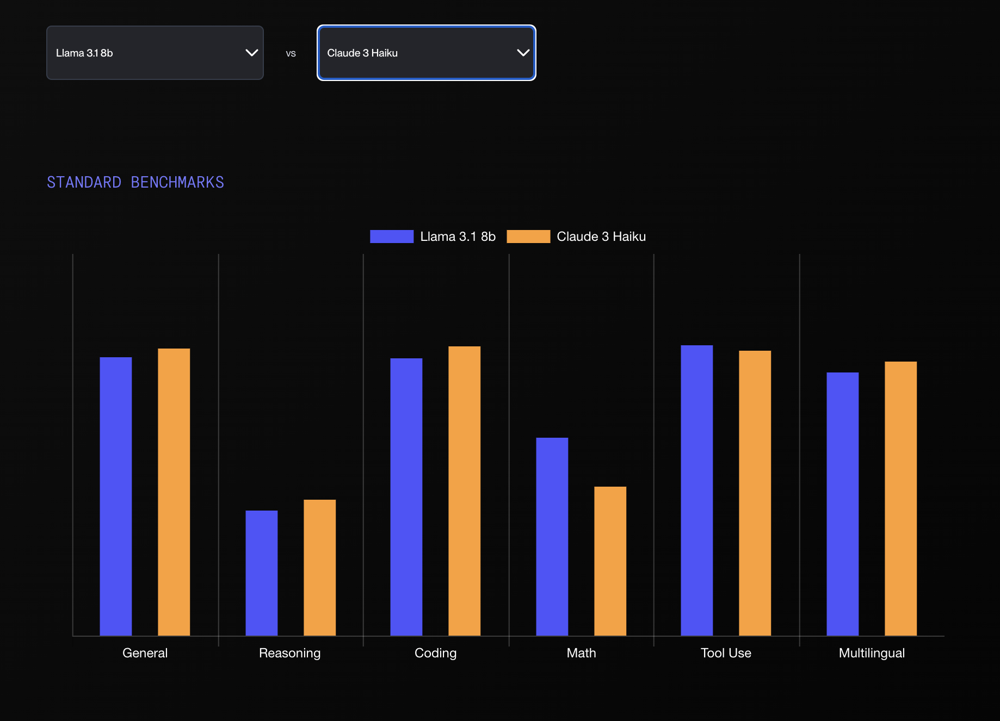

In [23]:
## load model ckpt from HF
model_ckpt = 'meta-llama/Llama-3.1-8B-Instruct'
model_ckpt

'meta-llama/Llama-3.1-8B-Instruct'

## QLoRA LLM Quantization
* We will use 4-bit quantization to load the LLM and save on memory and compute.

In [24]:
from torch import bfloat16
import transformers

## set quantization configuration to load LLM with less GPU memory
## requires `bitsandbytes` library

##bits and bytes config -- 32 bit to 4 bit
bnb_config = transformers.BitsAndBytesConfig(
    load_in_4bit=True, #4-bit quantization -- QLoRA
    bnb_4bit_quant_type='nf4', #normalized float 4
    bnb_4bit_use_double_quant=True, #second quantization after first
    bnb_4bit_compute_dtype=bfloat16 #computation type --brain float 16

)

## load model from hugging face hub

In [25]:
## llama-3.1 tokenizer
tokenizer = transformers.AutoTokenizer.from_pretrained(model_ckpt)

## llama 2 model instantiate
model = transformers.AutoModelForCausalLM.from_pretrained(
    model_ckpt,
    trust_remote_code=True,
    quantization_config=bnb_config, #quantization config from above
    device_map="auto"
)

## model params
model.eval()

Loading checkpoint shards:   0%|          | 0/4 [00:00<?, ?it/s]

LlamaForCausalLM(
  (model): LlamaModel(
    (embed_tokens): Embedding(128256, 4096)
    (layers): ModuleList(
      (0-31): 32 x LlamaDecoderLayer(
        (self_attn): LlamaAttention(
          (q_proj): Linear4bit(in_features=4096, out_features=4096, bias=False)
          (k_proj): Linear4bit(in_features=4096, out_features=1024, bias=False)
          (v_proj): Linear4bit(in_features=4096, out_features=1024, bias=False)
          (o_proj): Linear4bit(in_features=4096, out_features=4096, bias=False)
        )
        (mlp): LlamaMLP(
          (gate_proj): Linear4bit(in_features=4096, out_features=14336, bias=False)
          (up_proj): Linear4bit(in_features=4096, out_features=14336, bias=False)
          (down_proj): Linear4bit(in_features=14336, out_features=4096, bias=False)
          (act_fn): SiLU()
        )
        (input_layernorm): LlamaRMSNorm((4096,), eps=1e-05)
        (post_attention_layernorm): LlamaRMSNorm((4096,), eps=1e-05)
      )
    )
    (norm): LlamaRMSNorm((409

## Pipeline Setup
* Here we will setup a huggingface transformers pipeline for the LLM model.
* The ideal task we want is `text-generation`
* Penalty discourages repetitive or redundant output.
    * It is designed to address the tendency of language models to produce repeated phrases, sentences, or patterns.
    * In topic modeling we generally DO NOT want repetitive outputs.
* Temperature lower --> more deterministic!!

In [26]:
## setup a text generation pipeline
generator = transformers.pipeline(
    model=model,
    tokenizer=tokenizer,
    task='text-generation',
    temperature=0.1, ## lower more deterministic
    max_new_tokens=500,
    repetition_penalty=1.1
)

Device set to use cuda:0


# Prompt Engineering
* Test prompt template and model.

In [27]:
## test prompt
prompt = "Explain to me what Q, K, V are in transformer models as if I am 5 years old."
res = generator(prompt)
print(res[0]['generated_text'])

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


Explain to me what Q, K, V are in transformer models as if I am 5 years old. 

Imagine you have a toy box full of different colored blocks (Q). You want to make a new block tower using some of the blocks from the toy box (K). But you don't know which ones will be good for your tower yet. So, you ask your friend who is really good at building towers (V) to help you pick out the right blocks.

- **Q** (Query): The blocks you want to use to build your tower.
- **K** (Key-value pairs): All the blocks in the toy box that your friend has seen before. They're like all the possible blocks that could be used to build a tower.
- **V** (Value): Your friend's expertise and experience in building towers. They can tell you which blocks are good or bad for your specific tower.

In this analogy:

*   **Q** represents the input you give to the model (the blocks you want to use).
*   **K** represents the knowledge the model has learned from its training data (all the blocks it has seen before).
*   **V*

## Prompt Template for Llama-3
* The specific prompt template for the pre-trained Llama-3 model can be found here: https://www.llama.com/docs/model-cards-and-prompt-formats/llama3_1/
* Github with specific prompt templates: https://github.com/meta-llama/llama-models/blob/main/models/llama3_1/prompt_format.md

### Instruct Model Prompt Template
* There are 4 different roles that are supported by Llama text models:
1. `system:` Sets the context in which to interact with the AI model. It typically includes rules, guidelines, or necessary information that help the model respond effectively.

2. `user:` Represents the human interacting with the model. It includes the inputs, commands, and questions to the model.

3. `ipython:` A new role introduced in Llama 3.1. Semantically, this role means "tool". This role is used to mark messages with the output of a tool call when sent back to the model from the executor.

4. `assistant:` Represents the response generated by the AI model based on the context provided in the system, ipython and user prompts.
* The order should go like this: `[system, assistant, user, ipython]`

* There is a specific prompt template for this model:
```
<|begin_of_text|><|start_header_id|>system<|end_header_id|>

Cutting Knowledge Date: December 2023
Today Date: 23 July 2024

You are a helpful assistant<|eot_id|><|start_header_id|>user<|end_header_id|>

What is the capital of France?<|eot_id|><|start_header_id|>assistant<|end_header_id|>
```
* Another example of how to use this:
```
<|begin_of_text|><|start_header_id|>system<|end_header_id|>

You are a helpful assistant<|eot_id|><|start_header_id|>user<|end_header_id|>

Answer who are you in the form of jeopardy?<|eot_id|><|start_header_id|>assistant<|end_header_id|>

```
* Lamini documentation with additional examples of how to use the llama 3.1 and 3.2 prompt templates: https://docs.lamini.ai/inference/prompt_templates/
```
<|begin_of_text|><|start_header_id|>system<|end_header_id|>

{{ system_prompt }}<|eot_id|><|start_header_id|>user<|end_header_id|>

{{ user_message }}<|eot_id|><|start_header_id|>assistant<|end_header_id|>
```

## Prompt Template for Topic Modeling
* This is the recommended format for TOPIC MODELING.
* Most LLMs will do much better generating accurate responses if you give them examples to work from. Therefore we need to show an example of what we want our output to be.
* A note about the prompt content. It is better to keep it "general" and not specific to your domain or data because I have tried that before and the result creates hallucination issues for the LLM as it thinks it has to focus on the details of your prompt rather than performing topic modeling. Thus, the "boilerplate" prompt below which comes from the BERTopic Author Maarten G. is a great example to use and it works well.

* There are 3 components for this:
1. System Prompt
2. Example Prompt --> this is the most important prompt!
3. Main Prompt


### 1. System Prompt
* This is the first prompt needed.

In [28]:
## 1. system prompt describes info given to all conversations
system_prompt = """
<|begin_of_text|><|start_header_id|>system<|end_header_id|>

You are a helpful, respectful and honest assistant for labeling topics.<|eot_id|>

"""

### 2. Example Prompt 
* Give the example documents or text.
* Give example keywords.
* End by stating "please create a short label of this topic"

In [29]:
## 2. example prompt demonstrating output we want for topic modeling
example_prompt = """
<|begin_of_text|><|start_header_id|>system<|end_header_id|>

You are a helpful, respectful and honest assistant for labeling topics.<|eot_id|><|start_header_id|>user<|end_header_id|>

I have a topic that contains the following documents:
- Traditional diets in most cultures were primarily plant-based with a little meat on top, but with the rise of industrial style meat production and factory farming, meat has become a staple food.
- Meat, but especially beef, is the word food in terms of emissions.
- Eating meat doesn't make you a bad person, not eating meat doesn't make you a good one.

The topic is described by the following keywords: 'meat, beef, eat, eating, emissions, steak, food, health, processed, chicken'.

Based on the information about the topic above, please create a short label of this topic. Make sure you to only return the label and nothing more.<|eot_id|><|start_header_id|>assistant<|end_header_id|>

Environmental impacts of eating meat
"""

### 3. Main Prompt
* The `main_prompt` has spaces for us to insert the `DOCUMENTS` and `KEYWORDS` we want to use which will change as we perform TOPIC MODELING.

* There are two BERTopic-specific tags that are of interest, namely [DOCUMENTS] and [KEYWORDS]:
    * `[DOCUMENTS]` contain the top 5 most relevant documents to the topic
    * `[KEYWORDS]` contain the top 10 most relevant keywords to the topic as generated through c-TF-IDF algorithm from BERTopic.
* This template will be completed according to each topic.

In [30]:
## 3. main prompt with documents ([DOCUMENTS]) and keywords ([KEYWORDS]) tags
main_prompt = """
<|begin_of_text|><|start_header_id|>system<|end_header_id|>

You are a helpful, respectful and honest assistant for labeling topics.<|eot_id|><|start_header_id|>user<|end_header_id|>

I have a topic that contains the following documents:
[DOCUMENTS]

The topic is described by the following keywords: '[KEYWORDS]'.

Based on the information about the topic above, please create a short label of this topic. Make sure you to only return the label and nothing more.<|eot_id|><|start_header_id|>assistant<|end_header_id|>

"""

### 4. Final Prompt Template
* This is the final concatenation of all 3 prompts above that we will input to the LLM. 

In [31]:
## final prompt format
prompt = system_prompt + example_prompt + main_prompt

# BERTopic and Topic Modeling
* Now that the LLM is setup we can get into Topic Modeling.

## 1. Prepare Embeddings
* Pre-calculation of embeddings for each document to speed-up additional exploration steps and use the embeddings to quickly iterate over BERTopic's hyperparameters as needed.
* You can use ANY embedding model that you want to, here we will use a `SentenceTransformer` model.
It is best to probably consider a few different embeddings model based on your data and use case. The MTEB leaderboard is a good place to start as well as various data science methods to test which embedding model best represents the dimensions and contextual semantics of your data.
* Before we create our vector embeddings let's look at the token count of the document we are working with as it can influence the embedding model choice.

## Chunking
* Before we create embeddings we need to create chunks of the large document to cut it into smaller docs to make it more useful for BERTopic.
* Install the library for recursive chunking from chromadb

In [32]:
%%capture
!pip install git+https://github.com/brandonstarxel/chunking_evaluation.git
     

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [33]:
# Main Chunking Functions
from chunking_evaluation.chunking import (
    ClusterSemanticChunker,
    LLMSemanticChunker,
    FixedTokenChunker,
    RecursiveTokenChunker,
    KamradtModifiedChunker #semantic chunker
)
# Additional Data Science and ML Dependencies
import tiktoken
from chromadb.utils import embedding_functions
from chunking_evaluation.utils import openai_token_count
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [34]:
## function to analyze chunk sizes
def analyze_chunks(chunks, use_tokens=False):
    # Print the chunks of interest
    print("\nNumber of Chunks:", len(chunks))
    print("\n", "="*50, "19th Chunk", "="*50,"\n", chunks[19])
    print("\n", "="*50, "20th Chunk", "="*50,"\n", chunks[20])

    chunk1, chunk2 = chunks[19], chunks[20]

    if use_tokens:
        encoding = tiktoken.get_encoding("cl100k_base")
        tokens1 = encoding.encode(chunk1)
        tokens2 = encoding.encode(chunk2)

        # Find overlapping tokens
        for i in range(len(tokens1), 0, -1):
            if tokens1[-i:] == tokens2[:i]:
                overlap = encoding.decode(tokens1[-i:])
                print("\n", "="*50, f"\nOverlapping text ({i} tokens):", overlap)
                return
        print("\nNo token overlap found")
    else:
        # Find overlapping characters
        for i in range(min(len(chunk1), len(chunk2)), 0, -1):
            if chunk1[-i:] == chunk2[:i]:
                print("\n", "="*50, f"\nOverlapping text ({i} chars):", chunk1[-i:])
                return
        print("\nNo character overlap found")

### Initialize the recursive text splitter

In [35]:
## init recursive splitter
recursive_character_chunker = RecursiveTokenChunker(
    chunk_size=600,  # Character Length
    chunk_overlap=200,  # Overlap
    length_function=len,  # Character length with len()
    separators=["\n\n", "\n", ".", "?", "!", " ", ""] # add ChromaDB separators
)

## create chunks
chunks = recursive_character_chunker.split_text(content) ## pass text to this function

## analyze chunks
analyze_chunks(chunks, use_tokens=False)


Number of Chunks: 44

 ================================================== 19th Chunk ================================================== 
 Moderna welcomes new Board member Abbas Hussain
● More than 35 years of commercial
leadership and operating experience in healthcare, most recently serving as CEO of Vifor Pharma (2021-2023)
● Former Global President, Pharmaceuticals
&amp; Vaccines, GSK (2013-2017)
● Spent first 20 years of career with
Eli Lilly, culminating as President, European Operations
● Significant global vaccine
commercialization experience in emerging and mature markets

 ================================================== 20th Chunk ================================================== 
 Executive Committee updates
Stephen Hoge
Jacqueline Miller
Chief Medical
Tracey Franklin Chief People and Digital Technology
President
Leads strategy across
Rose Loughlin EVP, Research
Officer
Leads research Leads development Leads talent and
 organization organization digital functions
Office

## Token Counting
* This is always an important step in language modeling regardless of the embeddings or LLM you are using. As we know, some models like BERT take at max 512 tokens so we need to be weary of the token counts before we create vector embeddings. 
    * Since we are using a transformer model for creating embeddings we will use the same method for counting tokens as it is more accurate than the "white space" token counting method. 

In [36]:
## lets do white space count first
def count_tokens_simple(text):
    return len(text.split())

# Example usage
text_count = content
token_count = count_tokens_simple(text_count)
print(f"Approximate number of tokens: {token_count}")

Approximate number of tokens: 2327


Summary
* We should use a model that has a max sequence length at least longer than 2000 tokens.

In [37]:
import tiktoken
import numpy as np

## function to count number of tokens per chunk
def num_tokens_from_string(string: str, encoding_name: str) -> int:
  """Returns the number of tokens in a text string."""
  ##1. encode tokens
  encoding = tiktoken.get_encoding(encoding_name)
  ## 2. count tokens
  num_tokens = len(encoding.encode(string))

  return num_tokens
     

In [38]:
## apply function to `sent_chunks`
token_counts = [num_tokens_from_string(chunk, "cl100k_base") for chunk in chunks]

# calculate tokens
total_tokens = sum(token_counts)  # Calculate total tokens using 'sum'
average_tokens = total_tokens / len(chunks)  # Average using 'len(sent_chunks)'
max_tokens = max(token_counts)  # Get maximum token count
min_tokens = min(token_counts)  # Get minimum token count
std_tokens = round(np.std(token_counts),2)


## print results
print(f"Average tokens per chunk: {average_tokens}")
print(f"Maximum tokens per chunk: {max_tokens}")
print(f"Minimum tokens per chunk: {min_tokens}")
print(f"Standard deviation tokens per chunk {std_tokens}")

Average tokens per chunk: 103.29545454545455
Maximum tokens per chunk: 231
Minimum tokens per chunk: 5
Standard deviation tokens per chunk 45.71


Summary
* The chunks are smaller Let's just use the embedding model above as its dimensions are appropriate for this window size of text.

### Setup Embedding model
* Note about embeddings, I used this model: `mixedbread-ai/mxbai-embed-large-v1`
* model card: https://huggingface.co/mixedbread-ai/mxbai-embed-large-v1

In [39]:
%%capture
!pip install sentence-transformers

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [40]:
import numpy as np
from sentence_transformers import SentenceTransformer
from tqdm import tqdm

## load embedding model and weights from HF
#embedding_model = SentenceTransformer('mixedbread-ai/mxbai-embed-large-v1')

## function to create embeddings
def create_embeddings_for_chunks(chunks, embed_model=str, batch_size=32):
    """
    Create embeddings for a list of text chunks.
    
    :param chunks: List of text chunks
    :param model_name: Name of the Sentence Transformer model to use
    :param batch_size: Number of chunks to process at once
    :return: Numpy array of embeddings
    """
    # Load the model
    embed_model = SentenceTransformer(embed_model)
    
    # Initialize empty list to store embeddings
    embeddings = []
    
    # Process chunks in batches
    for i in tqdm(range(0, len(chunks), batch_size), desc="Creating embeddings"):
        batch = chunks[i:i+batch_size]
        batch_embeddings = embed_model.encode(batch)
        embeddings.extend(batch_embeddings)
    
    # Convert list of embeddings to numpy array
    embeddings = np.array(embeddings)
    
    return embeddings


Create the embeddings

In [41]:
# after splitting large text into chunks
# document_chunks = split_text(large_text) ## assume we already split chunks

# Create embeddings
embeddings = create_embeddings_for_chunks(chunks, 
                                          embed_model='mixedbread-ai/mxbai-embed-large-v1',
                                         batch_size=32)

# Convert to numpy array
embeddings = np.array(embeddings)

## get shape of embeddings
print(f"Shape of embeddings: {embeddings.shape}")

Creating embeddings: 100%|██████████| 2/2 [00:00<00:00,  5.80it/s]

Shape of embeddings: (44, 1024)


In [42]:
type(embeddings)

numpy.ndarray

In [43]:
## dim of numpy array
embeddings.shape

(44, 1024)

In [44]:
## need to reshape embeddings to 2D
#embeddings = embeddings.squeeze(0)
#embeddings.shape

In [45]:
## check gpu info
!nvidia-smi

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Fri Jan 31 14:26:35 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.127.08             Driver Version: 550.127.08     CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA RTX A6000               On  |   00000000:C5:00.0 Off |                  Off |
| 30%   39C    P2             73W /  300W |    7612MiB /  49140MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

install rapids-cuml accelerator 
* To use this must be run before the cell you run the UMAP and HDBSCAN in
```
%load_ext cuml.experimental.accel
```

## 2. Sub-models
* Next step is to define a few sub-models in BERTopic.
* Then we can do some small tweaks to the number of clusters to be created, setting random_states and more.
* NOTE: A technique I am NOT using here but is worth trying is hyperparameter tuning using bayesian optimization which would help us choose more refined parameters.

In [78]:
%%time
from umap import UMAP ## dimensionality reduction
from hdbscan import HDBSCAN ## density based clustering algorithm

## create umap model
umap_model = UMAP(n_neighbors=15,
                  n_components=5,
                  min_dist=0.0,
                  metric='cosine',
                  random_state=42)

## create hdbscan model
hdbscan_model = HDBSCAN(min_cluster_size=2, ## larger number --> less topics                       
                        metric='euclidean',
                        cluster_selection_method='eom',
                        prediction_data=True)

CPU times: user 0 ns, sys: 67 µs, total: 67 µs
Wall time: 79.9 µs


We will also reduce the embeddings just created to 2 dimensions so we can use them for visualization purposes after creating topics.

In [79]:
%%time
## pre-reduce embeddings for visualization
reduced_embeddings = UMAP(n_neighbors=15,
                          n_components=2,
                          min_dist=0.0,
                          metric='cosine',
                          random_state=42).fit_transform(embeddings)

CPU times: user 48.9 ms, sys: 0 ns, total: 48.9 ms
Wall time: 47.9 ms


We will also reduce the embeddings just created to 2 dimensions so we can use them for visualization purposes after creating topics.

## 3. Representation Models
* One of the ways we are going to represent the topics is with the LLM Llama-3. 
* This should give us a nice set of quality labels for the topics.
* However, we might want to have additional representations to view a topic from MULTIPLE angles.
* Below we will use the c-TF-IDF from BERTopic as the main representation, and KeyBERT, MMR, and Llama-3 as the additional representations.

In [80]:
## import representation models from BERTopic
from bertopic.representation import KeyBERTInspired, MaximalMarginalRelevance, TextGeneration

## 1. KeyBERT
keybert = KeyBERTInspired()

## 2. MMR
mmr = MaximalMarginalRelevance(diversity=0.7) ## higher value --> more diversity keywords

## 3. Text Generation with Llama 2 LLM
llama3 = TextGeneration(generator, prompt=prompt)

### ALL Representation models combined
representation_model = {
    "KeyBERT": keybert,
    "Llama3": llama3,
    "MMR": mmr,
}

# Topic Model Training
* Now that ALL models are prepared, we can start training the TOPIC MODEL. BERTopic is what we are using.
* We will do the following:
1. Input "sub-models" to BERTopic.
2. Run `.fit_transform`
3. Evaluate Topic outputs

In [81]:
embed_model='mixedbread-ai/mxbai-embed-large-v1'

In [82]:
%%time
## import BERTopic
from bertopic import BERTopic
from tqdm import tqdm

## setup topic model
topic_model = BERTopic(

  # sub-models - 4 models
  embedding_model=embed_model, #1
  umap_model=umap_model, #2
  hdbscan_model=hdbscan_model, #3
  representation_model=representation_model, #4

  # hyperparameters
  top_n_words=10,
  verbose=True,
)

# Train topic model
topics, probs = tqdm(topic_model.fit_transform(chunks, embeddings))

2025-01-31 14:40:23,057 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-01-31 14:40:23,107 - BERTopic - Dimensionality - Completed ✓
2025-01-31 14:40:23,108 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-01-31 14:40:23,112 - BERTopic - Cluster - Completed ✓
2025-01-31 14:40:23,113 - BERTopic - Representation - Extracting topics from clusters using representation models.
100%|██████████| 5/5 [00:02<00:00,  1.85it/s]
2025-01-31 14:40:26,391 - BERTopic - Representation - Completed ✓
100%|██████████| 2/2 [00:00<00:00, 71089.90it/s]

CPU times: user 3min 23s, sys: 9.96 s, total: 3min 32s
Wall time: 19.3 s


# Topic Model Results Evaluation

In [83]:
## get topic info
topic_model.get_topic_info()

,Topic,Count,Name,Representation,KeyBERT,Llama3,MMR,Representative_Docs
0,0,13,0_and_billion_amp_sales,"[and, billion, amp, sales, stéphane, net, banc...","[cfo, financials, earnings, ceo, 3q, revenue, ...","[Biotech company quarterly earnings report, , ...","[billion, amp, stéphane, bancel, ceo, 3q24, 20...",[3Q24 earnings call agenda\nBusiness Review St...
1,1,12,1_mrna_000_phase_study,"[mrna, 000, phase, study, to, 1010, vaccine, n...","[mrna, vaccine, preclinical, vaccination, fda,...",[Medical research and development of mRNA vacc...,"[phase, 1010, nsclc, efficacy, voucher, fluari...",[Respiratory vaccines\nNext-gen COVID\nmRNA-12...
2,2,9,2_2023_and_iqvia_in,"[2023, and, iqvia, in, for, retail, the, encom...","[cdc, vaccination, pharmacies, vaccines, retai...","[COVID-19 Vaccination Rates in the US, , , , ,...","[2023, and, iqvia, retail, aug, idn, va, audit...",[Based on information licensed from IQVIA: IQV...
3,3,5,3_sec_forward_statements_looking,"[sec, forward, statements, looking, these, the...","[statements, disclaims, securities, future, un...",[Forward-looking statements in corporate finan...,"[sec, forward, which, moderna, uncertainties, ...","[. These risks, uncertainties, and other facto..."
4,4,5,4_moderna_rsv_of_2024,"[moderna, rsv, of, 2024, to, in, and, regardin...","[pharma, moderna, 2024, pharmaceuticals, rsv, ...",[Moderna's Respiratory Vaccine Business Update...,"[moderna, rsv, 2024, mresvia, sales, years, la...",[RSV commercial update\n2024/2025 season\nOppo...


# Closer look at 1 topic

In [84]:
## pick 1 topic to look closely at
topic_model.get_topic(0, full=True)['KeyBERT']

[('cfo', 0.6784168),
 ('financials', 0.6624348),
 ('earnings', 0.6250084),
 ('ceo', 0.6223707),
 ('3q', 0.6207691),
 ('revenue', 0.5946101),
 ('2023', 0.5935745),
 ('2024', 0.5725286),
 ('calculation', 0.5713362),
 ('3q24', 0.5697864)]

In [85]:
## pick 1 topic to look closely at
topic_model.get_topic(0, full=True)['MMR']

[('billion', 0.05717162297786172),
 ('amp', 0.05600439057302869),
 ('stéphane', 0.05281073646737077),
 ('bancel', 0.05281073646737077),
 ('ceo', 0.05145446068007555),
 ('3q24', 0.05145446068007555),
 ('2024', 0.044241297182321754),
 ('30', 0.038701282494374434),
 ('earnings', 0.038701282494374434),
 ('call', 0.03356538036434469)]

In [86]:
## pick 1 topic to look closely at
topic_model.get_topic(0, full=True)['Llama3']

[('Biotech company quarterly earnings report', 1),
 ('', 0),
 ('', 0),
 ('', 0),
 ('', 0),
 ('', 0),
 ('', 0),
 ('', 0),
 ('', 0),
 ('', 0)]

# Assign Topic Labels using Llama-3 LLM

In [87]:
## generate topic labels using llama2 LLM
llama3_labels = [label[0][0].split("\n")[0] for label in topic_model.get_topics(full=True)["Llama3"].values()]

## Tag topic labels to topic_model dataframe
topic_model.set_topic_labels(llama3_labels)

In [88]:
## print labels
llama3_labels

['Biotech company quarterly earnings report',
 'Medical research and development of mRNA vaccines',
 'COVID-19 Vaccination Rates in the US',
 'Forward-looking statements in corporate finance',
 "Moderna's Respiratory Vaccine Business Update"]

In [95]:
## labels
pd.DataFrame(llama3_labels)

,0
0,Biotech company quarterly earnings report
1,Medical research and development of mRNA vaccines
2,COVID-19 Vaccination Rates in the US
3,Forward-looking statements in corporate finance
4,Moderna's Respiratory Vaccine Business Update


# Create Topic dataframe from topic model

In [89]:
# Get topic info
topic_info = topic_model.get_topic_info()

# Create a dataframe from the topic info
df_topic = pd.DataFrame(topic_info)
df_topic.head()


,Topic,Count,Name,CustomName,Representation,KeyBERT,Llama3,MMR,Representative_Docs
0,0,13,0_and_billion_amp_sales,Biotech company quarterly earnings report,"[and, billion, amp, sales, stéphane, net, banc...","[cfo, financials, earnings, ceo, 3q, revenue, ...","[Biotech company quarterly earnings report, , ...","[billion, amp, stéphane, bancel, ceo, 3q24, 20...",[3Q24 earnings call agenda\nBusiness Review St...
1,1,12,1_mrna_000_phase_study,Medical research and development of mRNA vaccines,"[mrna, 000, phase, study, to, 1010, vaccine, n...","[mrna, vaccine, preclinical, vaccination, fda,...",[Medical research and development of mRNA vacc...,"[phase, 1010, nsclc, efficacy, voucher, fluari...",[Respiratory vaccines\nNext-gen COVID\nmRNA-12...
2,2,9,2_2023_and_iqvia_in,COVID-19 Vaccination Rates in the US,"[2023, and, iqvia, in, for, retail, the, encom...","[cdc, vaccination, pharmacies, vaccines, retai...","[COVID-19 Vaccination Rates in the US, , , , ,...","[2023, and, iqvia, retail, aug, idn, va, audit...",[Based on information licensed from IQVIA: IQV...
3,3,5,3_sec_forward_statements_looking,Forward-looking statements in corporate finance,"[sec, forward, statements, looking, these, the...","[statements, disclaims, securities, future, un...",[Forward-looking statements in corporate finan...,"[sec, forward, which, moderna, uncertainties, ...","[. These risks, uncertainties, and other facto..."
4,4,5,4_moderna_rsv_of_2024,Moderna's Respiratory Vaccine Business Update,"[moderna, rsv, of, 2024, to, in, and, regardin...","[pharma, moderna, 2024, pharmaceuticals, rsv, ...",[Moderna's Respiratory Vaccine Business Update...,"[moderna, rsv, 2024, mresvia, sales, years, la...",[RSV commercial update\n2024/2025 season\nOppo...


In [121]:
## function to clean up data
def process_df_topic(df):
    # Specify the columns to keep
    columns_to_keep = ['CustomName', 'Representation', 'KeyBERT', 'Llama3', 'MMR', 'Representative_Docs']
    
    # Keep only the specified columns
    df = df[columns_to_keep]
    
    # Function to convert list to string if it's a list, otherwise return as is
    def list_to_string(x):
        if isinstance(x, list):
            return ' '.join(map(str, x))
        return x
    
    # Apply the function to all columns except 'CustomName'
    for col in df.columns:
        if col != 'CustomName':
            df[col] = df[col].apply(list_to_string)
    
    return df


In [122]:
## apply function
df_new = process_df_topic(df_topic)
df_new.head()

,CustomName,Representation,KeyBERT,Llama3,MMR,Representative_Docs
0,Biotech company quarterly earnings report,and billion amp sales stéphane net bancel ceo ...,cfo financials earnings ceo 3q revenue 2023 20...,Biotech company quarterly earnings report ...,billion amp stéphane bancel ceo 3q24 2024 30 e...,3Q24 earnings call agenda\nBusiness Review Sté...
1,Medical research and development of mRNA vaccines,mrna 000 phase study to 1010 vaccine nsclc wit...,mrna vaccine preclinical vaccination fda vacci...,Medical research and development of mRNA vacci...,phase 1010 nsclc efficacy voucher fluarix 4157...,Respiratory vaccines\nNext-gen COVID\nmRNA-128...
2,COVID-19 Vaccination Rates in the US,2023 and iqvia in for retail the encompasses t...,cdc vaccination pharmacies vaccines retail pre...,COVID-19 Vaccination Rates in the US,2023 and iqvia retail aug idn va audit cdc cha...,Based on information licensed from IQVIA: IQVI...
3,Forward-looking statements in corporate finance,sec forward statements looking these the and o...,statements disclaims securities future uncerta...,Forward-looking statements in corporate financ...,sec forward which moderna uncertainties factor...,". These risks, uncertainties, and other factor..."
4,Moderna's Respiratory Vaccine Business Update,moderna rsv of 2024 to in and regarding for mr...,pharma moderna 2024 pharmaceuticals rsv 2025 2...,Moderna's Respiratory Vaccine Business Update ...,moderna rsv 2024 mresvia sales years label abi...,RSV commercial update\n2024/2025 season\nOppor...


In [123]:
## export to csv
df_new.to_csv('Moderna_Topics.csv',index=False)

In [103]:
df_topic.dtypes

Topic                   int64
Count                   int64
Name                   object
CustomName             object
Representation         object
KeyBERT                object
Llama3                 object
MMR                    object
Representative_Docs    object
dtype: object

# Interactive Topic Explorer Visualization

In [90]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=2, cols=1, subplot_titles=("Keywords", "MMR Terms"))

fig.add_trace(go.Bar(x=[], y=[], name="Keywords"), row=1, col=1)
fig.add_trace(go.Bar(x=[], y=[], name="MMR Terms"), row=2, col=1)

fig.update_layout(
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=[{"x": [df_topic['KeyBERT'][i], df_topic['MMR'][i]],
                           "y": [list(range(len(df_topic['KeyBERT'][i]))), 
                                 list(range(len(df_topic['MMR'][i])))]
                          }],
                    label=df_topic['CustomName'][i],
                    method="update"
                ) for i in df_topic.index
            ]),
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.1,
            xanchor="left",
            y=1.15,
            yanchor="top"
        ),
    ],
    height=600,
    title_text="Topic Explorer"
)

# Update traces to show the first topic by default
if len(df_topic) > 0:
    fig.update_traces(
        x=[df_topic['KeyBERT'][0]], 
        y=[list(range(len(df_topic['KeyBERT'][0])))], 
        selector=dict(name="Keywords")
    )
    fig.update_traces(
        x=[df_topic['MMR'][0]], 
        y=[list(range(len(df_topic['MMR'][0])))], 
        selector=dict(name="MMR Terms")
    )

fig.show()

# Interactive Word Cloud

In [91]:
%%capture
!pip install wordcloud

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [92]:
import pandas as pd
import plotly.graph_objects as go
from wordcloud import WordCloud
import io
import base64

# Assuming df_topic is your dataframe with columns 'CustomName', 'KeyBERT', and 'MMR'

def create_wordcloud(words):
    # Increase the size of the WordCloud
    wc = WordCloud(width=1200, height=800, background_color='white', min_font_size=10).generate_from_frequencies(words)
    img = wc.to_image()
    with io.BytesIO() as buffer:
        img.save(buffer, 'png')
        img_str = base64.b64encode(buffer.getvalue()).decode()
    return f'data:image/png;base64,{img_str}'

# Function to create an interactive word cloud
def create_interactive_wordcloud(data, title):
    wordclouds = {}
    for index, row in data.iterrows():
        word_freq = {word: 1/i for i, word in enumerate(row['Words'], 1)}
        wordclouds[row['Topic']] = create_wordcloud(word_freq)

    fig = go.Figure()

    fig.add_trace(go.Image(source=list(wordclouds.values())[0]))

    fig.update_layout(
        title=title,
        updatemenus=[
            dict(
                active=0,
                buttons=list([
                    dict(label=topic,
                         method="update",
                         args=[{"source": [wordclouds[topic]]}])
                    for topic in data['Topic']
                ]),
            )
        ],
        annotations=[
            dict(text="Select Topic:", showarrow=False,
                 x=0, y=1.05, yref="paper", align="left"),
        ]
    )

    # Increase the size of the Plotly figure
    fig.update_layout(height=900, width=1300)  # Adjusted size

    return fig

# Prepare data for KeyBERT keywords
keybert_data = pd.DataFrame({
    'Topic': df_topic['CustomName'],
    'Words': df_topic['KeyBERT']
})

# Prepare data for MMR terms
mmr_data = pd.DataFrame({
    'Topic': df_topic['CustomName'],
    'Words': df_topic['MMR']
})

# Create and display the interactive word cloud for KeyBERT keywords
fig_keybert = create_interactive_wordcloud(keybert_data, "Interactive Word Cloud - Topics and KeyBERT Keywords")
fig_keybert.show()

# Create and display the interactive word cloud for MMR terms
fig_mmr = create_interactive_wordcloud(mmr_data, "Interactive Word Cloud - MMR Terms")
fig_mmr.show()

# Appendix

## How to handle various cluster sizes
* Depending on the size of the dataset you are using, you may encounter errors suggesting that the number of clusters (k) you're trying to create is greater than the number of data points you have.
* This will likely occur due to the `min_cluster_size` parameter in the HDBSCAN model being too large for your dataset.
* As an example, in the data above I only had 44 chunks, so setting a large `min_cluster_size=150` in the HDBSCAN model is problematic because it's trying to create clusters that are larger than the entire dataset.
* To fix this, you simply need to adjust the `min_cluster_size` parameter to a value that's appropriate for the data size.
* Here is what I did:
    * I started by reducing the `min_cluster_size` in the HDBSCAN model.
    * Given that there are 44 chunks, I experimented with values between 2 and 5 which allowed HDBSCAN to form clusters given the limited data points.
    * The key here is that the model does not acccept cluster sizes of less than 2. 
* Remember, with only 44 chunks, I was working with a very small dataset for topic modeling.
* This is where increasing the dataset size if possible (e.g. number of clusters) might help.
* Otherwise be prepared for potentially less meaningful or stable topics due to the limited data.

In [ ]:
## Here's an example of modification of the HDBSCAN model
hdbscan_model = HDBSCAN(min_cluster_size=2,  # or 3, depending on how many topics you want
                        metric='euclidean',
                        cluster_selection_method='eom',
                        prediction_data=True)

## However, If you want to control the number of topics more precisely, it is best to consider using a different clustering algorithm that 
## allows you to specify the number of clusters directly, such as KMeans. 
## You can do this by importing KMeans from sklearn and using it instead of HDBSCAN
## however, it is important to consider that KMeans is an entirely different clustering algorithm than HDBSCAN and if you really want to be precise with 
## using kmeans you need to consider what your k should be based on your data (e.g. elbow, silohuette score)
## also consider the purity of the clusters
from sklearn.cluster import KMeans

## init kmeans model
kmeans_model = KMeans(n_clusters=5)  # or however many topics you want

topic_model = BERTopic(
    embedding_model=embed_model,
    umap_model=umap_model,
    hdbscan_model=kmeans_model,  # Use KMeans instead of HDBSCAN
    representation_model=representation_model,
    top_n_words=10,
    verbose=True,
)


### Still another option is to use BERTopic's built-in method for controlling the number of topics
## however this requires some experimentation
topic_model = BERTopic(
    embedding_model=embed_model,
    umap_model=umap_model,
    hdbscan_model=None,  # Let BERTopic handle clustering
    representation_model=representation_model,
    top_n_words=10,
    verbose=True,
    nr_topics=5  # Or however many topics you want
)


## Script for Loading Data from S3 bucket on AWS

In [ ]:
import boto3
import s3fs
from sagemaker import get_execution_role
conn = boto3.client('s3')

## load s3 bucket
bucket = 'adamnlpbucket1'
content = conn.list_objects(Bucket=bucket)['Contents']
data_key= '<your S3 bucket csv file location goes here>'
data_location= 's3://{}/{}'.format(bucket,data_key)

## load df
df = pd.read_csv(data_location, index_col= False, low_memory=False)
df.head()